In [1]:
from datacube_ows.styles.api import *


In [2]:
def plot_image(xr_image, x="x", y="y", size=10):
    rgb = xr_image.to_array(dim="color")
    rgb = rgb.transpose(*(rgb.dims[1:] + rgb.dims[:1]))
    rgb = rgb / 255
    rgb.plot.imshow(x=x, y=y, size=size)

In [3]:
from datacube import Datacube
dc = Datacube()
data = dc.load(
    product='ls8_nbart_geomedian_annual',
    measurements=['red', 'green', 'blue'],
    latitude=(-16.1144, -13.4938),
    longitude=(140.7184, 145.6924),
    time=('2019-01', '2019-01'),
    output_crs="EPSG:3577",
    resolution=(-300,300)
)

/env/lib/python3.6/site-packages/datacube/drivers/postgres/_connections.py:87: SADeprecationWarning: Calling URL() directly is deprecated and will be disabled in a future release.  The public constructor for URL is now the URL.create() method.
  username=username, password=password,


In [4]:
rgb_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": {"green": 1.0},
        "blue": {"blue": 1.0},
    },
    "scale_range": (50, 3000),
}

In [5]:
from datacube_ows.styles.api import StandaloneStyle, apply_ows_style_cfg, xarray_image_as_png

xr_image = apply_ows_style_cfg(rgb_cfg, data)

In [6]:
xr_image


<xarray.Dataset>
Dimensions:      (x: 1879, y: 1113)
Coordinates:
  * y            (y) float64 -1.459e+06 -1.46e+06 ... -1.793e+06 -1.793e+06
  * x            (x) float64 9.368e+05 9.370e+05 9.374e+05 ... 1.5e+06 1.5e+06
    spatial_ref  int32 3577
Data variables:
    red          (y, x) uint8 11 11 12 12 12 13 12 12 ... 16 16 18 16 19 20 18
    green        (y, x) uint8 18 18 18 19 19 19 19 18 ... 21 21 23 21 23 25 23
    blue         (y, x) uint8 30 30 30 30 31 31 30 30 ... 38 38 40 38 40 42 39

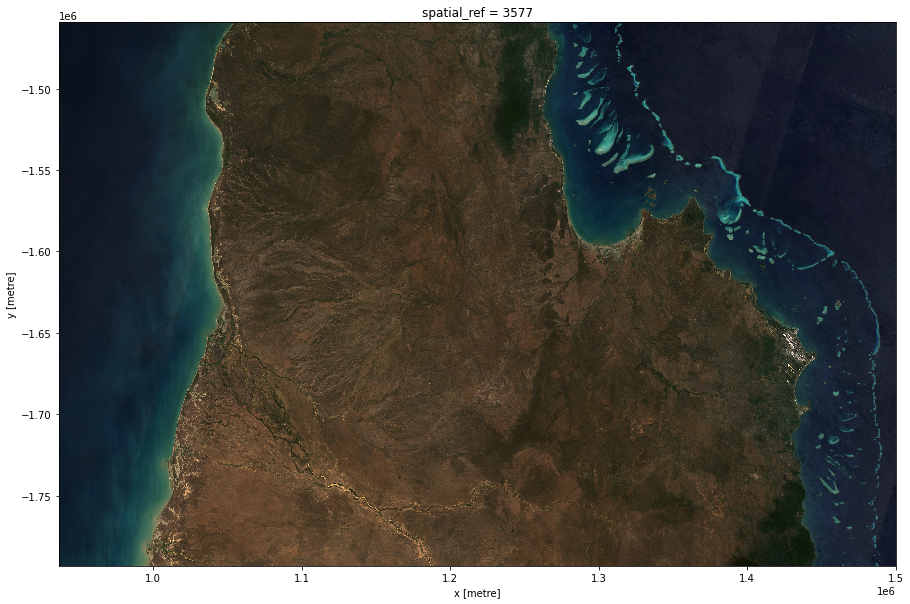

In [7]:
plot_image(xr_image)

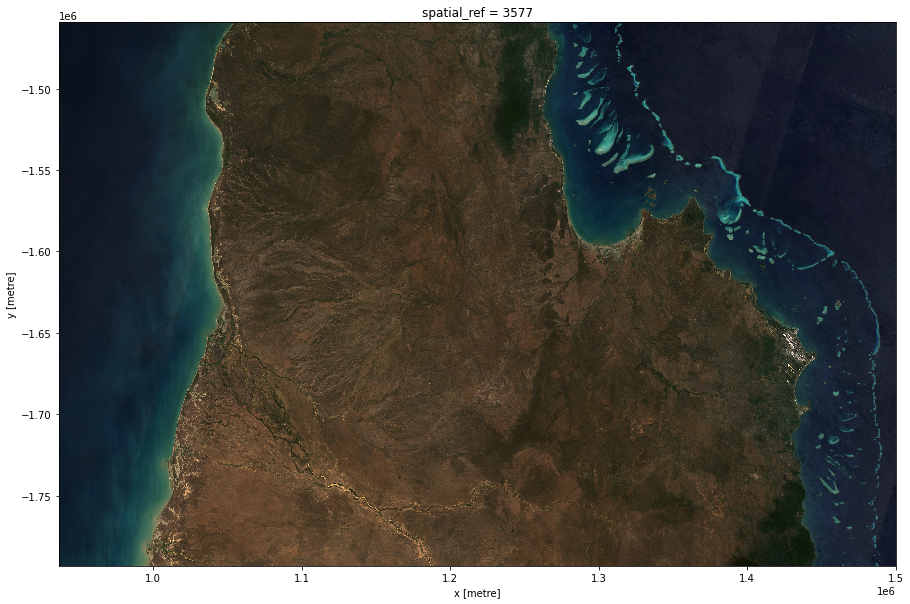

In [8]:
plot_image(apply_ows_style_cfg(rgb_cfg, data))

In [9]:
rgb_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": {"green": 1.0},
        "blue": {"blue": 1.0},
    },
    "scale_range": (50, 3000),
}

In [10]:
from datacube import Datacube
dc = Datacube()
data = dc.load(
    product='ls8_nbart_geomedian_annual',
    measurements=['red', 'green', 'blue', 'nir', 'swir1', 'swir2'],
    latitude=(-16.1144, -13.4938),
    longitude=(140.7184, 145.6924),
    time=('2019-01', '2019-01'),
    output_crs="EPSG:3577",
    resolution=(-300,300)
)

/env/lib/python3.6/site-packages/datacube/drivers/postgres/_connections.py:87: SADeprecationWarning: Calling URL() directly is deprecated and will be disabled in a future release.  The public constructor for URL is now the URL.create() method.
  username=username, password=password,


In [11]:
ir_green_cfg = {
    "components": {
        "red": {
            "swir1": 1.0
        },
        "green": {
            "nir": 1.0
        },
        "blue": {
            "green": 1.0
        },
    },
    "scale_range": (50, 3000),
}

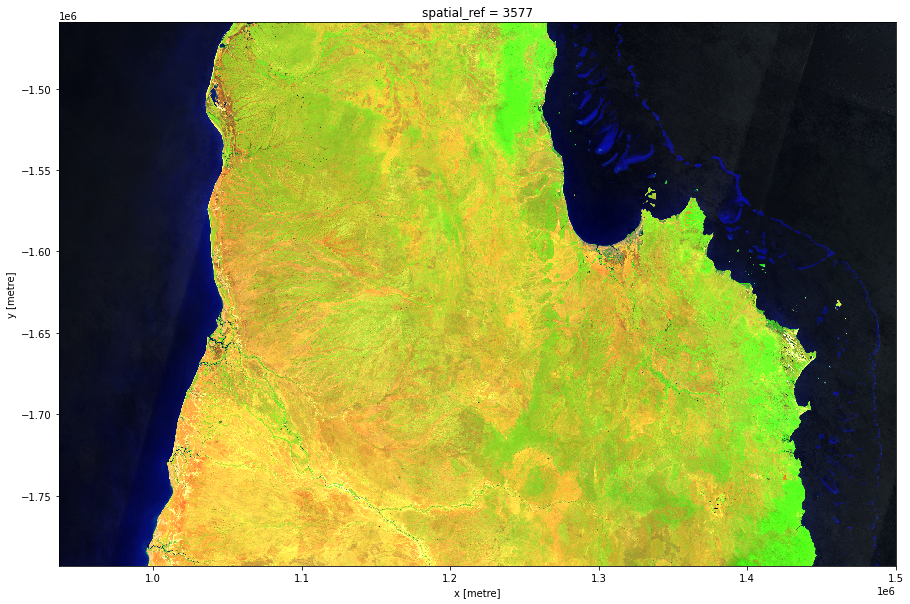

In [12]:
plot_image(apply_ows_style_cfg(ir_green_cfg, data))

In [13]:
pure_red_cfg = {
    "components": {
        "red": {
         "red": 1.0
        },
        "green": {
         "red": 1.0
        },
        "blue": {
         "red": 1.0
        },
    },
    "scale_range": (50, 3000),
}


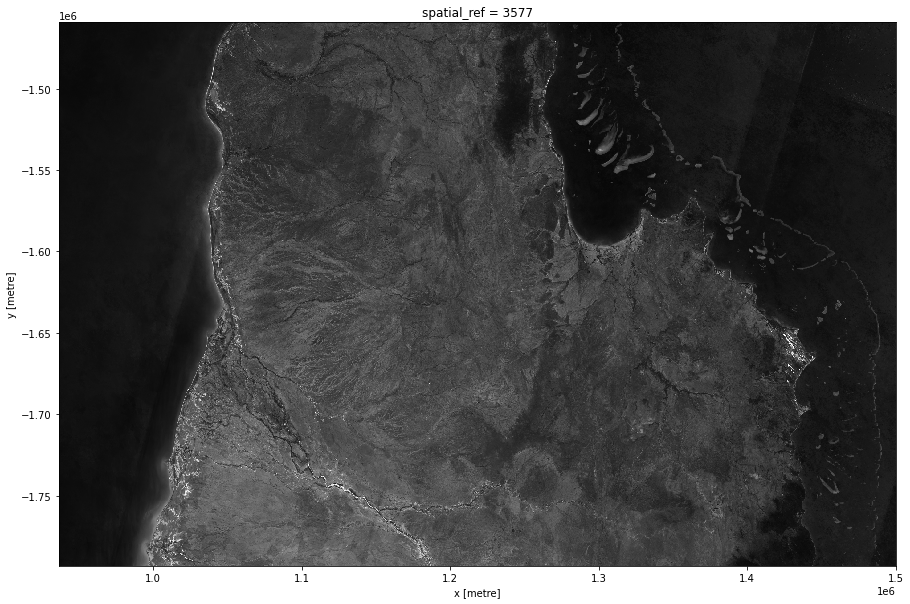

In [14]:
plot_image(apply_ows_style_cfg(pure_red_cfg, data))

In [15]:
very_red_cfg = {
    "components": {
        "red": {
         "red": 1.0
        },
        "green": {
        },
        "blue": {
        },
    },
    "scale_range": (50, 3000),
}

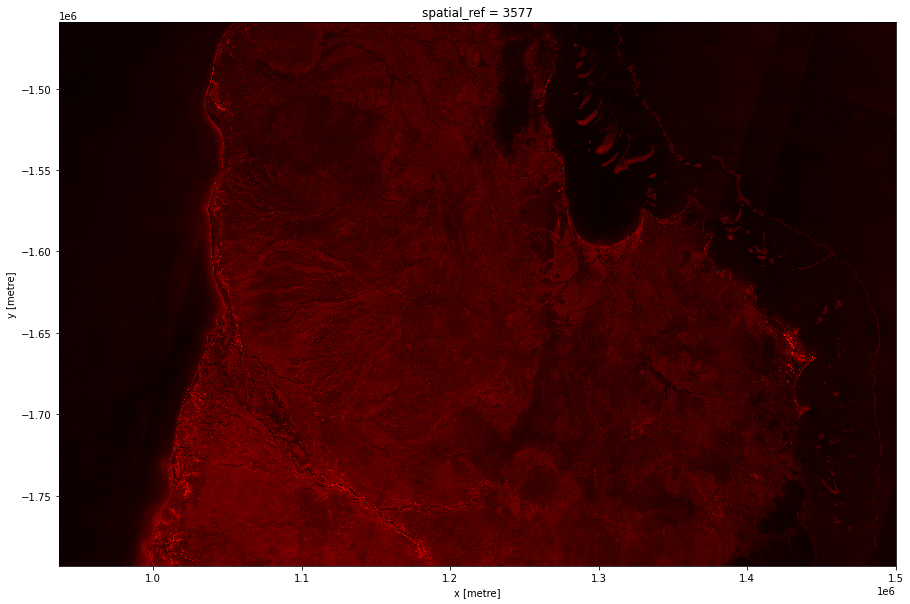

In [16]:
plot_image(apply_ows_style_cfg(very_red_cfg, data))

In [17]:
all_bands_cfg = {
    "components": {
        "red": {
            # Weighting factors should sum to (close to) 1.0
            # 0.333 + 0.333 + 0.333 = 0.999 ~ 1.0
            "red": 0.333,
            "green": 0.333,
            "blue": 0.333,
        },
        "green": {
            # Weighting factors should sum to (close to) 1.0
            # So use 1.0 for a single band.
            "nir": 1.0
        },
        "blue": {
            # Weighting factors should sum to (close to) 1.0
            # 0.5 + 0.5 = 1.0
            "swir1": 0.5,
            "swir2": 0.5,
        },
    },
    "scale_range": (50, 3000),
}

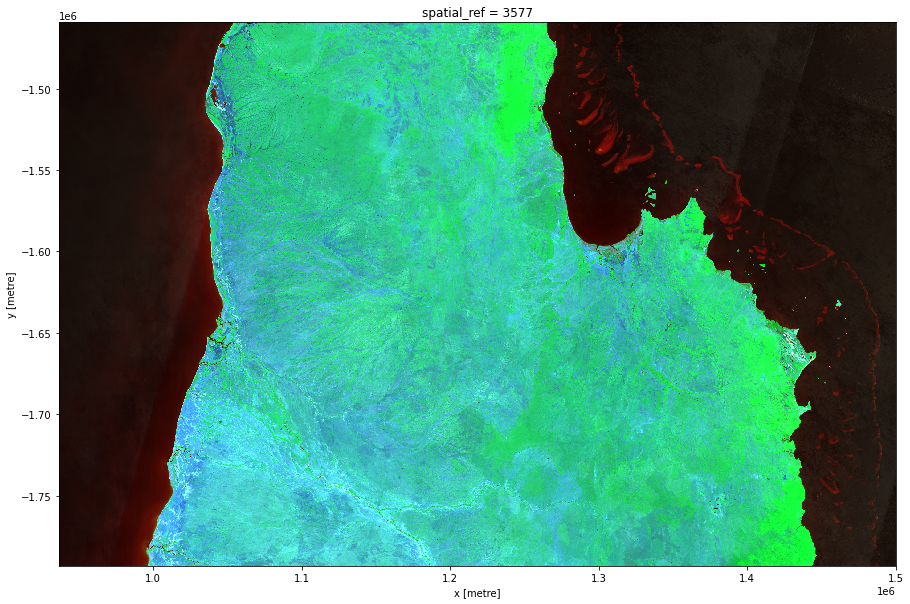

In [18]:
plot_image(apply_ows_style_cfg(all_bands_cfg, data))

In [26]:
rgb_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": {"green": 1.0},
        "blue": {"blue": 1.0},
    },
    "scale_range": (1000, 3000),
}

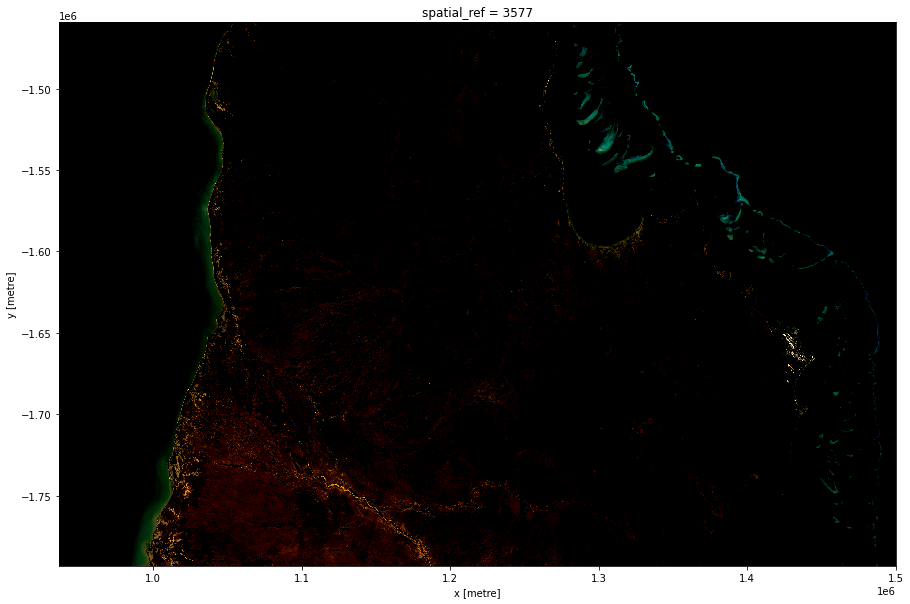

In [27]:
plot_image(apply_ows_style_cfg(rgb_cfg, data))

In [28]:
irg_bandscale_cfg = {
    "components": {
        "red": {
            "swir1": 1.0,
            "scale_range": (1500, 3700),
        },
        "green": {
            "nir": 1.0,
            "scale_range": (1600, 3200),
        },
        "blue": {
            "green": 1.0
        },
    },
    "scale_range": (200, 1900),
}

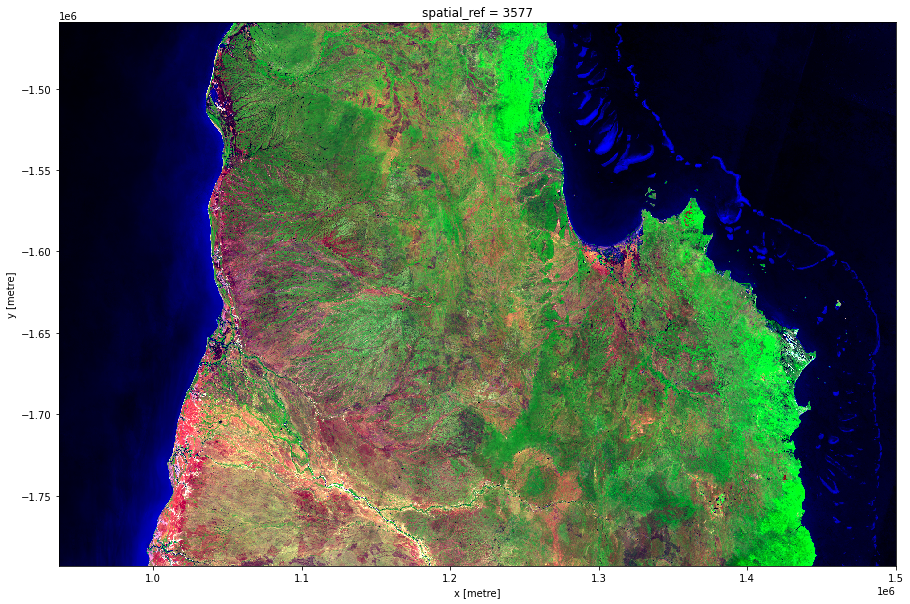

In [29]:
plot_image(apply_ows_style_cfg(irg_bandscale_cfg, data))

In [31]:
def ndvi(data):
    # Returns data in range (-1, 1)
    return (data["nir"] - data["red"]) / (data["nir"] + data["red"])

In [32]:
rgb_ndvi_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": ndvi,
        "blue": {"blue": 1.0},
    },
    "scale_range": (50, 3000),
}

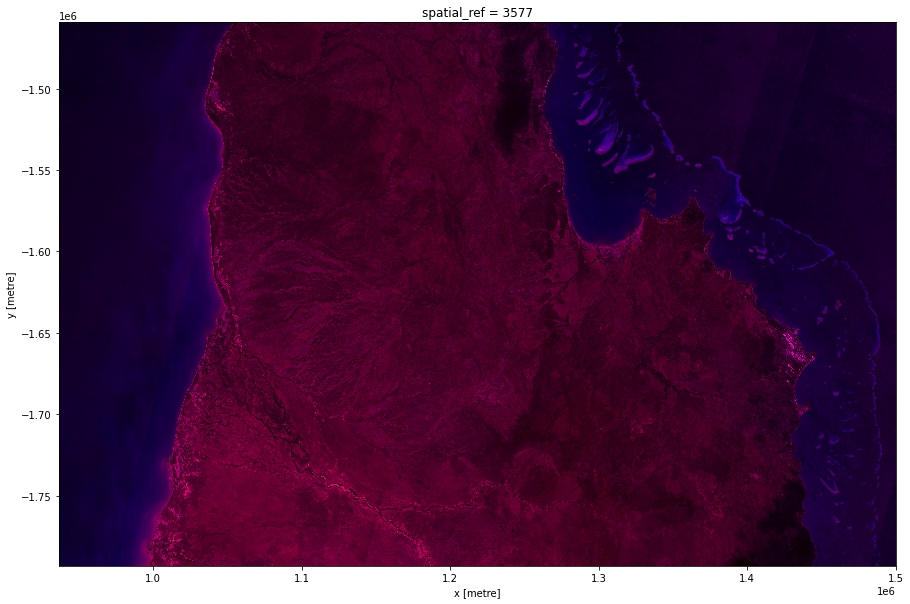

In [33]:
plot_image(apply_ows_style_cfg(rgb_ndvi_cfg, data))

In [34]:
def ndvi(data):
    # Calculate NDVI (-1.0 to 1.0)
    unscaled = (data["nir"] - data["red"])/(data["nir"] + data["red"])

    # Scale to [-1.0 - 1.0] to [0 - 255]
    scaled = ((unscaled + 1.0) * 255/2).clip(0, 255)

    return scaled

r_ndvi_b_fullrange_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": ndvi,
        "blue": {"blue": 1.0},
    },
    "scale_range": (50, 3000),
}

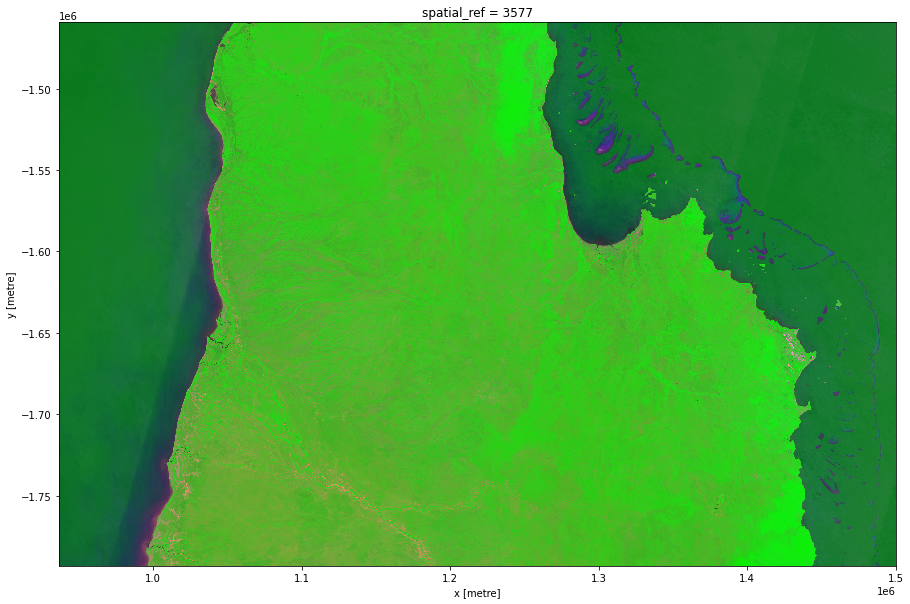

In [35]:
plot_image(apply_ows_style_cfg(r_ndvi_b_fullrange_cfg, data))

In [36]:
@scalable
def scaled_ndvi(data):
    # Calculate NDVI (-1.0 to 1.0)
    return (data["nir"] - data["red"])/(data["nir"] + data["red"])

In [37]:
r_ndvi_b_halfrange_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": {
            "function": scaled_ndvi,
            # In addition to the standard API calling argument (the input data),
            # additional positional or keyword arguments can
            # be passed to the function using an args array and/or a kwargs dictionary.
            "kwargs": {
                "scale_from": (0.0, 1.0),
                "scale_to": (0, 255)
            }
        },
        "blue": {"blue": 1.0},
    },
    "scale_range": (50, 3000),
}

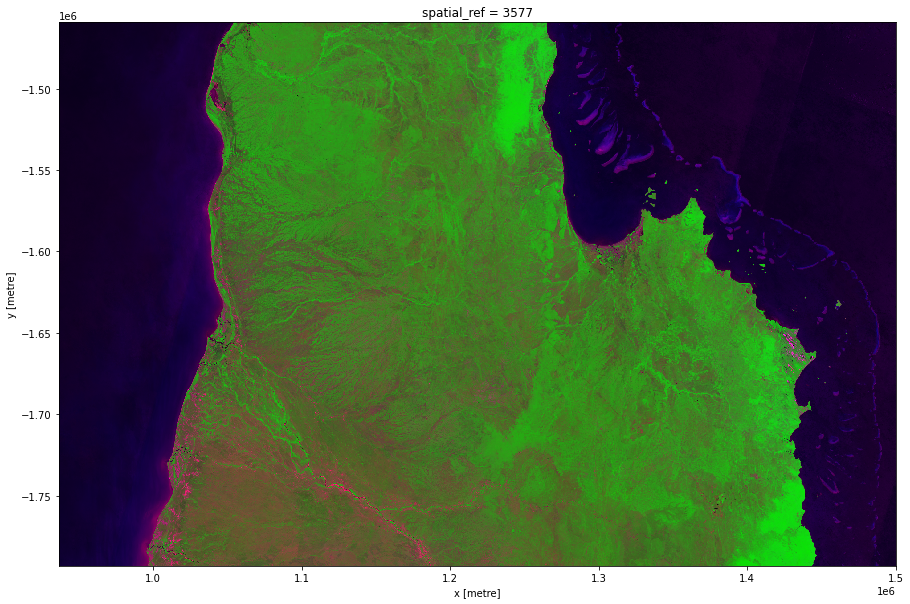

In [38]:
plot_image(apply_ows_style_cfg(r_ndvi_b_halfrange_cfg, data))

In [39]:
r_ndvi_ndwi_halfrange_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": {
            "function": "datacube_ows.band_utils.norm_diff",
            "kwargs": {
                "band1": "nir",
                "band2": "red",
                "scale_from": (0.0, 1.0),
                "scale_to": (0, 255)
            }
        },
        "blue": {
            "function": "datacube_ows.band_utils.norm_diff",
            "kwargs": {
                "band1": "green",
                "band2": "nir",
                "scale_from": (0.0, 1.0),
                "scale_to": (0, 255)
            }
        },
    },
    "scale_range": (50, 3000),
}

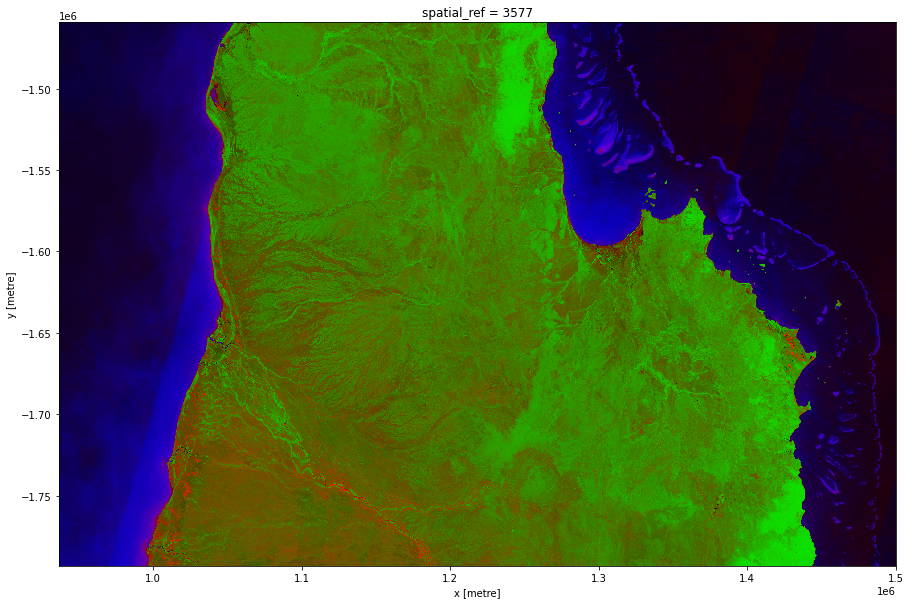

In [40]:
plot_image(apply_ows_style_cfg(r_ndvi_ndwi_halfrange_cfg, data))

In [41]:
ndvi_bidirection_cfg = {
    "index_function": {
        "function": "datacube_ows.band_utils.norm_diff",
        "kwargs": {"band1": "nir", "band2": "red"},
    },
    "mpl_ramp": "RdYlGn",
    "range": [-1.0, 1.0]
}

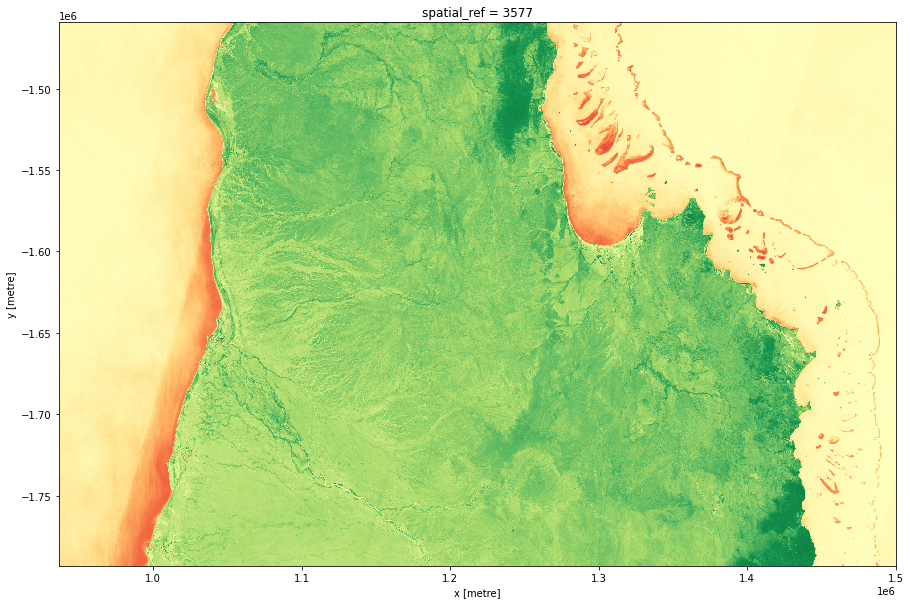

In [42]:
plot_image(apply_ows_style_cfg(ndvi_bidirection_cfg, data))

In [43]:
ndvi_unidirection_cfg = {
    "index_expression": "(nir-red)/(nir+red)",
    "mpl_ramp": "ocean_r",    #  ocean_r is the "ocean" ramp, reversed.
    "range": [0.0, 1.0]
}

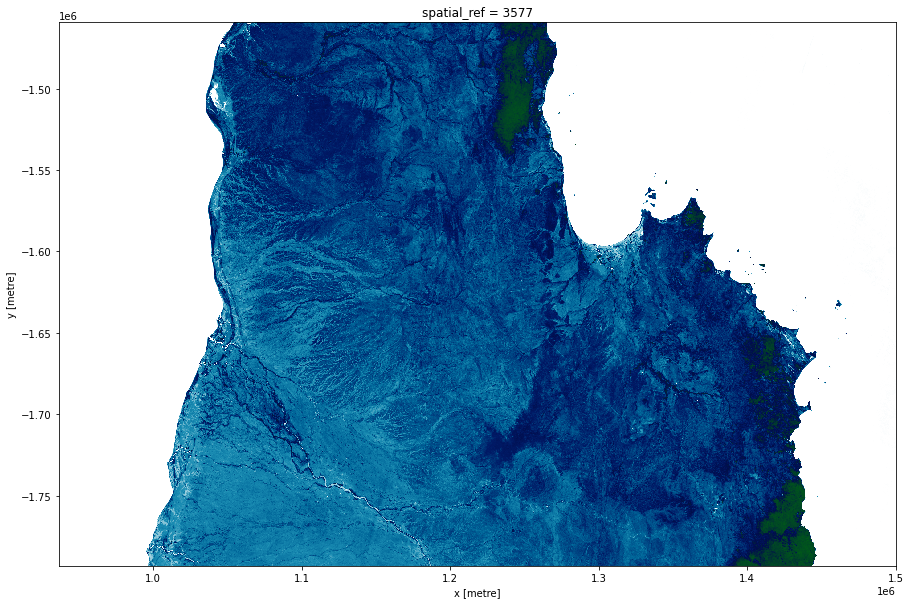

In [44]:
plot_image(apply_ows_style_cfg(ndvi_unidirection_cfg, data))

In [45]:
ndvi_custom_ramp_cfg = {
    "index_function": {
        "function": "datacube_ows.band_utils.norm_diff",
        "kwargs": {"band1": "nir", "band2": "red"},
    },
    "color_ramp": [
    # The ramp starts at -1.0 with bright blue.
    # Any values less than -1.0 would also be pegged at bright blue
    # (But -1.0 is the hard minimum for NDVI, so that is not relevant here.)

    {"value": -1.0, "color": "#0000FF"},

    # The next step is -0.2 which is a dark greenish blue.
    # Between -1.0 and -0.2 the colour is linearly interpolated,
    # gradually morphing from bright blue to dark greenish blue.

    {"value": -0.2, "color": "#005050",},

    # From -0.2 to -0.1, morph from the dark greenish blue to a dark grey at -0.01

    {"value": -0.1, "color": "#505050",},

    # I've deliberately spread out -0.01 to 0.01, so we can see if there is any
    # interesting fine detail in areas close to zero.
    # It morphs from dark grey (-0.1) to pure black (0.0), then brightens to a
    # a dark green.

    {"value": -0.01, "color": "#303030",},
    {"value": 0.0, "color": "black",},
    {"value": 0.01, "color": "#003000",},

    # Finally the positive value morphs from: dark green (0.01), to dark yellow (0.5) to
    # a salmony-pink by 1.0.

    {"value": 0.5, "color": "#707030",},
    {"value": 1.0, "color": "#FF9090",},

    # Values above 1.0 would be pegged at salmony-pink, but again, this does not apply
    # here because 1.0 is the absolute maximum value of NDVI (that's what the N means!)
]
}


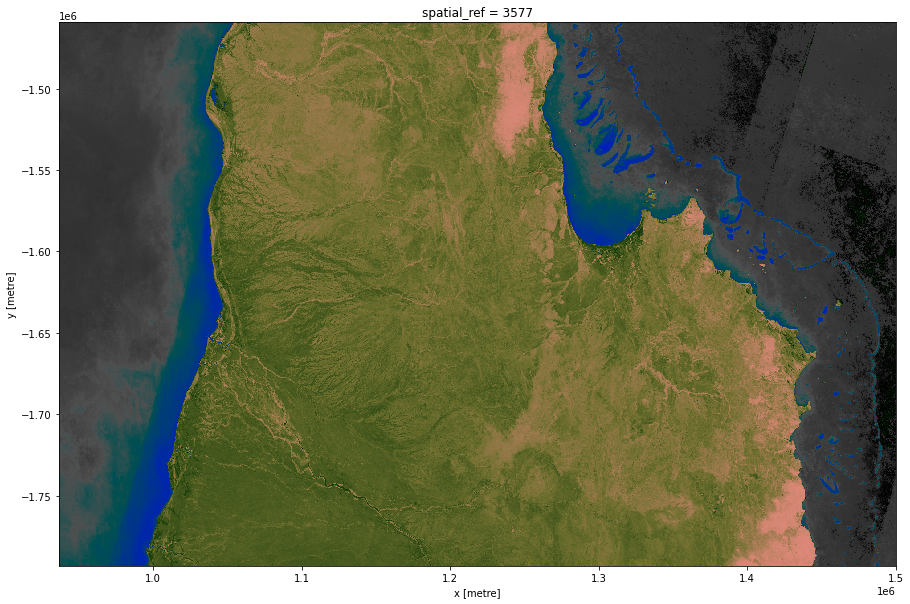

In [46]:
plot_image(apply_ows_style_cfg(ndvi_custom_ramp_cfg, data))

In [47]:
ndvi_custom_ramp_alpha_cfg = {
    "index_function": {
        "function": "datacube_ows.band_utils.norm_diff",
        "kwargs": {"band1": "nir", "band2": "red"},
    },
    "color_ramp": [
        # For NDVI -1.0 to 0.0, the image is fully transparent.

        {
            "value": -1.0,
            "color": "#000000",
            "alpha": 0.0,
        },
        {
            "value": 0.0,
            "color": "#000000",
            "alpha": 0.0,
        },

        # For NDVI 0.0 to 0.1, the transparency gradually reduces to zero and colour
        # fades from black to dark blue.

        {
            "value": 0.1,
            "color": "#000030",
            "alpha": 1.0,
        },

        # For NDVI 0.1 to 0.3 colour brightens from dark blue to a dark purple

        {
            "value": 0.3,
            "color": "#703070",
        },

        # For NDVI 0.3 to 0.6 colour brightens from purple to yellow.

        {
            "value": 0.6,
            "color": "#e0e070",
        },

        # For NDVI 0.6 to 1.0 colour brightens from yellow to bright green.

        {
            "value": 1.0,
            "color": "#90FF90",
        }
    ]
}

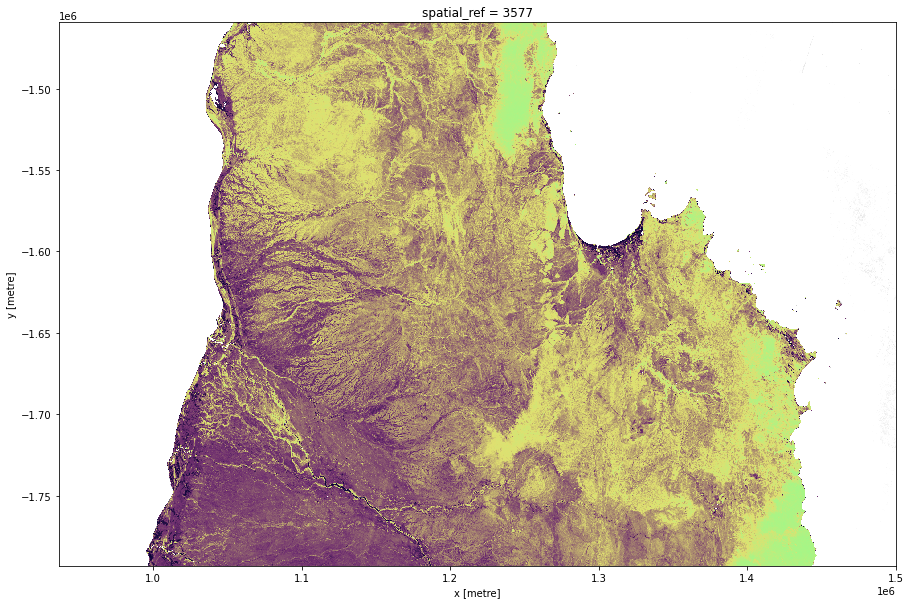

In [48]:
plot_image(apply_ows_style_cfg(ndvi_custom_ramp_alpha_cfg, data))

In [49]:
from datacube import Datacube
dc = Datacube()

data = dc.load(
    product='ga_ls_wo_3',
    measurements=['water'],
    latitude=(-15.9098, -15.0496),
    longitude=(128.0882, 129.2171),
    time=('2020-12-24T10:00:00', '2020-12-25T09:59:59'),
    output_crs="EPSG:3577",
    resolution=(-120,120),
    group_by="solar_day"
)

/env/lib/python3.6/site-packages/datacube/drivers/postgres/_connections.py:87: SADeprecationWarning: Calling URL() directly is deprecated and will be disabled in a future release.  The public constructor for URL is now the URL.create() method.
  username=username, password=password,


In [50]:
data['water'].attrs


{'units': '1',
 'nodata': 1,
 'flags_definition': {'dry': {'bits': [7, 6, 5, 4, 3, 2, 1, 0],
   'values': {'0': True},
   'description': 'No water detected'},
  'wet': {'bits': [7, 6, 5, 4, 3, 2, 1, 0],
   'values': {'128': True},
   'description': 'Clear and Wet'},
  'cloud': {'bits': 6,
   'values': {'0': False, '1': True},
   'description': 'Cloudy'},
  'nodata': {'bits': 0,
   'values': {'0': False, '1': True},
   'description': 'No data'},
  'high_slope': {'bits': 4,
   'values': {'0': False, '1': True},
   'description': 'High slope'},
  'cloud_shadow': {'bits': 5,
   'values': {'0': False, '1': True},
   'description': 'Cloud shadow'},
  'noncontiguous': {'bits': 1,
   'values': {'0': False, '1': True},
   'description': 'At least one EO band is missing or saturated'},
  'terrain_shadow': {'bits': 3,
   'values': {'0': False, '1': True},
   'description': 'Terrain shadow'},
  'water_observed': {'bits': 7,
   'values': {'0': False, '1': True},
   'description': 'Classified as wat

In [51]:
simple_map_cfg = {
    "value_map": {
        # Value_map maps a band to a list of rules.
        # Do not put multiple bands with independent rules into a single value_map. It
        # may appear to work, but in practice you cannot guarantee which band will be checked
        # for matches first, and therefore the output may render inconsistently from one python
        # instance to another.
        "water": [
            {
                "title": "Water",
                "abstract": "",
                "flags": {"water_observed": True},
                "color": "Aqua",
            },
            {
                "title": "Cloud",
                "abstract": "",
                "flags": {"cloud": True},
                "color": "Beige",
            },
            {
                "title": "Terrain",
                "abstract": "",
                # Flag rules can contain an "or" - they match if either of the conditions hold.
                "flags": {"or": {"terrain_shadow": True, "high_slope": True}},
                "color": "SlateGray",
            },
            {
                "title": "Cloud Shadow and High Slope",
                "abstract": "",
                # Flag rules can contain an "and" - they match if all of the conditions hold.
                "flags": {"and": {"cloud_shadow": True, "high_slope": True}},
                "color": "DarkKhaki",
            },
            {
                "title": "Dry",
                "abstract": "",
                "flags": {"water_observed": False},
                "color": "Brown",
            },
        ]
    }
}

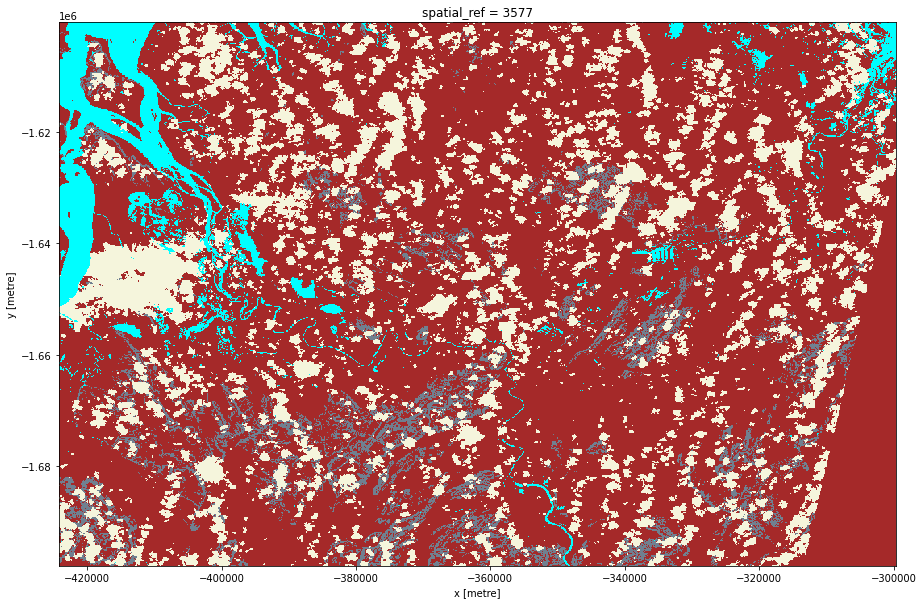

In [52]:
plot_image(apply_ows_style_cfg(simple_map_cfg, data))

In [53]:
better_map_cfg = {
    "name": "observations",
    "title": "Observations",
    "abstract": "Observations",
    "value_map": {
        "water": [
            # Cloudy Slopes rule needs to come before the Cloud
            # and High Slopes rules.
            {
                "title": "Cloudy Slopes",
                "abstract": "",
                "flags": {"and": {"cloud": True, "high_slope": True}},
                "color": "BurlyWood",
            },
            # Only matches non-cloudy high-slopes.
            {
                "title": "High Slopes",
                "abstract": "",
                "flags": {"high_slope": True},
                "color": "Brown",
            },
            {
                "title": "Cloud",
                "abstract": "",
                "flags": {"cloud": True},
                "color": "Beige",
            },
            {
                "title": "Cloud Shadow",
                "abstract": "",
                "flags": {"cloud_shadow": True},
                "color": "SlateGray",
            },
            # Match water AFTER special pixels.
            {
                "title": "Water",
                "abstract": "",
                "flags": {"water_observed": True},
                "color": "Aqua",
            },
            {
                "title": "Dry",
                "abstract": "",
                "flags": {"water_observed": False},
                "color": "SaddleBrown",
            },
        ]
    }
}

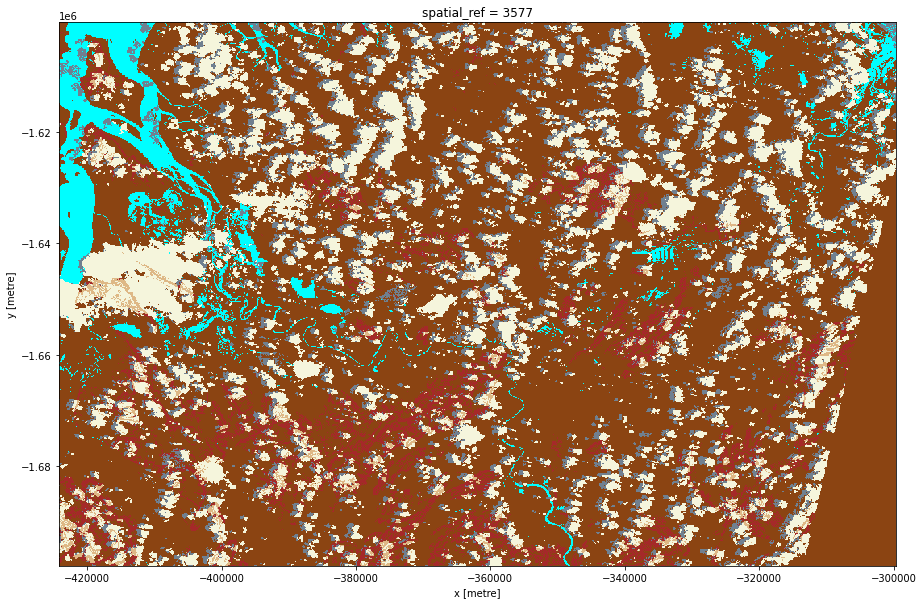

In [54]:
plot_image(apply_ows_style_cfg(better_map_cfg, data))

In [63]:
transparency_map_config = {
    "value_map": {
        "water": [
            {
                # Make noncontiguous and invalid data transparent
                "title": "",
                "abstract": "",
                "flags": {
                    "or": {
                        "noncontiguous": True,
                        "nodata": True,
                     },
                },
                "alpha": 0.0,
                "color": "#ffffff",
            },
            {
                "title": "Cloudy Steep Terrain",
                "abstract": "",
                "flags": {
                    "and": {
                        "high_slope": True,
                        "cloud": True
                    }
                },
                "color": "#f2dcb4",
            },
            {
                "title": "Cloudy Water",
                "abstract": "",
                "flags": {
                    "and": {
                        "water_observed": True,
                        "cloud": True
                    }
                },
                "color": "#bad4f2",
            },
            {
                "title": "Shaded Water",
                "abstract": "",
                "flags": {
                    "and": {
                        "water_observed": True,
                        "cloud_shadow": True
                    }
                },
                "color": "#335277",
            },
            {
                "title": "Cloud",
                "abstract": "",
                "flags": {"cloud": True},
                "color": "#c2c1c0",
            },
            {
                "title": "Cloud Shadow",
                "abstract": "",
                "flags": {"cloud_shadow": True},
                "color": "#4b4b37",
            },
            {
                "title": "Terrain Shadow or Low Sun Angle",
                "abstract": "",
                "flags": {
                    "or": {
                        "terrain_shadow": True,
                        "low_solar_angle": True
                    },
                },
                "color": "#2f2922",
            },
            {
                "title": "Steep Terrain",
                "abstract": "",
                "flags": {"high_slope": True},
                "color": "#776857",
            },
            {
                "title": "Water",
                "abstract": "",
                "flags": {
                    "water_observed": True,
                },
                "color": "#4f81bd",
            },
            {
                "title": "Dry",
                "abstract": "",
                "flags": {"water_observed": False},
                "color": "#96966e",
            },
        ]
    }}

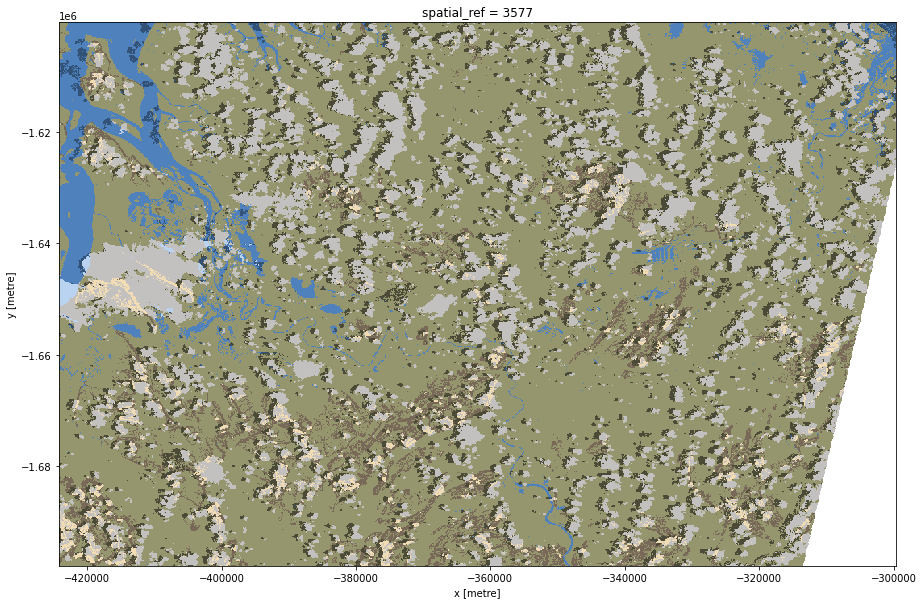

In [65]:
plot_image(apply_ows_style_cfg(transparency_map_config, data))

In [66]:
import xarray as xr
from datacube import Datacube
dc = Datacube()

wofs_data = dc.load(
    product='ga_ls_wo_3',
    measurements=['water'],
    latitude=(-15.9098, -15.0496),
    longitude=(128.0882, 129.2171),
    time=('2020-12-08T10:00:00', '2020-12-09T09:59:59'),
    output_crs="EPSG:3577",
    resolution=(-120,120),
    group_by="solar_day"
)

fc_data = dc.load(
    product='ga_ls_fc_3',
    measurements=['bs', 'pv', 'npv'],
    latitude=(-15.9098, -15.0496),
    longitude=(128.0882, 129.2171),
    time=('2020-12-08T10:00:00', '2020-12-09T09:59:59'),
    output_crs="EPSG:3577",
    resolution=(-120,120),
    group_by="solar_day"
)

# Time coordinates come back slightly differently from the two products, so we need
# to align them before we combine.

wofs_data.coords["time"] = fc_data.coords["time"]
combined_data = xr.combine_by_coords(
        [fc_data, wofs_data],
        join="exact")

/env/lib/python3.6/site-packages/datacube/drivers/postgres/_connections.py:87: SADeprecationWarning: Calling URL() directly is deprecated and will be disabled in a future release.  The public constructor for URL is now the URL.create() method.
  username=username, password=password,


In [67]:
combined_data

<xarray.Dataset>
Dimensions:      (time: 1, x: 1038, y: 815)
Coordinates:
  * time         (time) datetime64[ns] 2020-12-09T01:30:07.738427
  * y            (y) float64 -1.6e+06 -1.6e+06 ... -1.698e+06 -1.698e+06
  * x            (x) float64 -4.241e+05 -4.24e+05 ... -2.998e+05 -2.997e+05
    spatial_ref  int32 3577
Data variables:
    bs           (time, y, x) uint8 3 0 0 0 0 16 8 ... 255 255 255 255 255 255
    pv           (time, y, x) uint8 0 2 0 0 1 13 38 ... 255 255 255 255 255 255
    npv          (time, y, x) uint8 97 98 99 100 99 69 ... 255 255 255 255 255
    water        (time, y, x) uint8 0 0 0 0 0 0 0 0 0 0 ... 1 1 1 1 1 1 1 1 1 1
Attributes:
    crs:           EPSG:3577
    grid_mapping:  spatial_ref

In [68]:
unmasked_fc_cfg =  {
    "components": {
        "red": {"bs": 1.0},
        "green": {"pv": 1.0},
        "blue": {"npv": 1.0}
    },
    "scale_range": [0.0, 100.0],
}

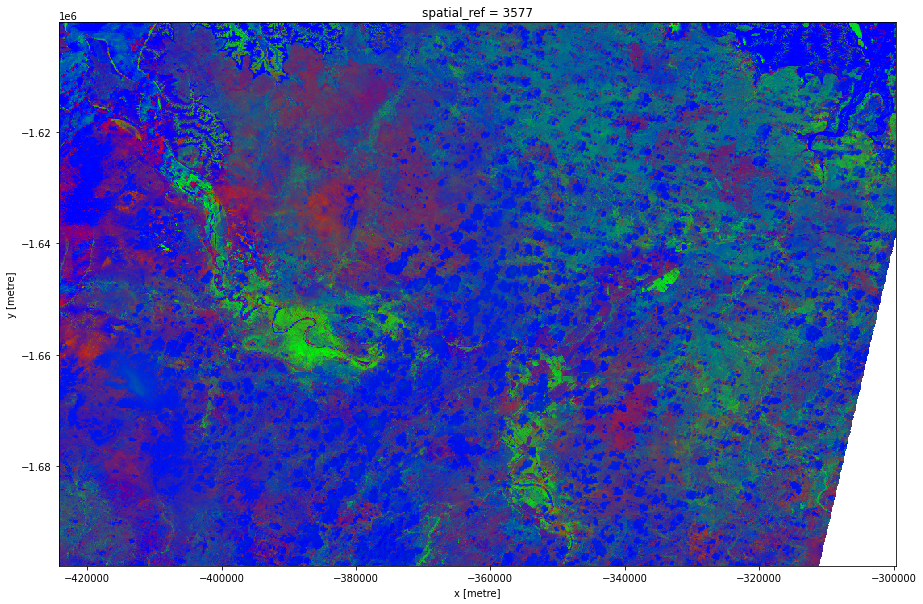

In [70]:
plot_image(apply_ows_style_cfg(unmasked_fc_cfg, combined_data))

In [71]:
masked_fc_cfg =  {
    "components": {
        "red": {"bs": 1.0},
        "green": {"pv": 1.0},
        "blue": {"npv": 1.0}
    },
    "scale_range": [0.0, 100.0],
    "pq_masks": [
        # Pixels must match all flags to remain visible.
        {
            "band": "water",
            "flags": {
                "nodata": False,
                "noncontiguous": False,
                "terrain_shadow": False,
                "low_solar_angle": False,
                "high_slope": False,
                "cloud_shadow": False,
                "cloud": False,
                "water_observed": False,
            }
        }
    ]
}

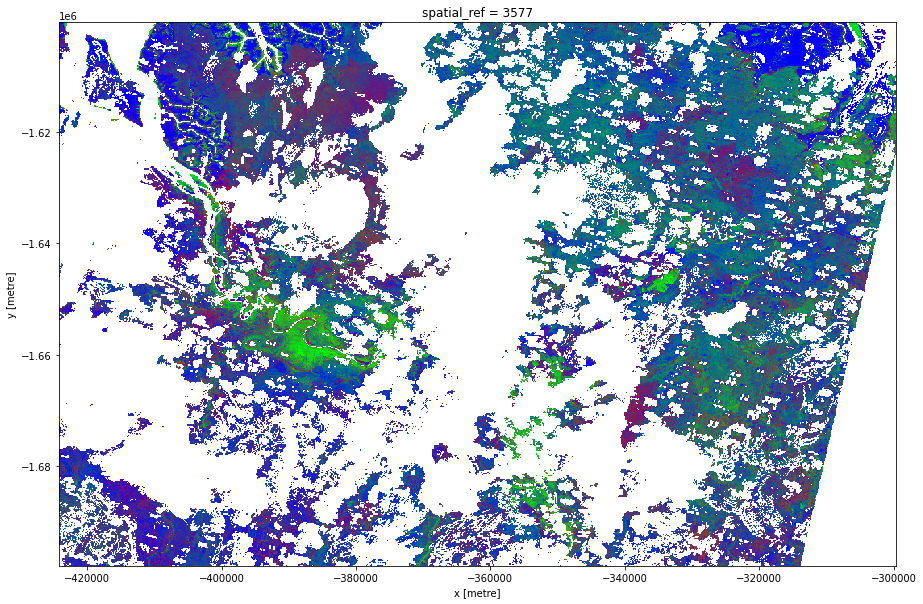

In [72]:
plot_image(apply_ows_style_cfg(masked_fc_cfg, combined_data))

In [76]:
enum_masked_fc_cfg =  {
    "components": {
        "red": {"bs": 1.0},
        "green": {"pv": 1.0},
        "blue": {"npv": 1.0}
    },
    "scale_range": [0.0, 100.0],
    "pq_masks": [
        {
            "band": "water",
            "invert": True,
            "enum": 1, # 1 = nodata
        }
    ]
}

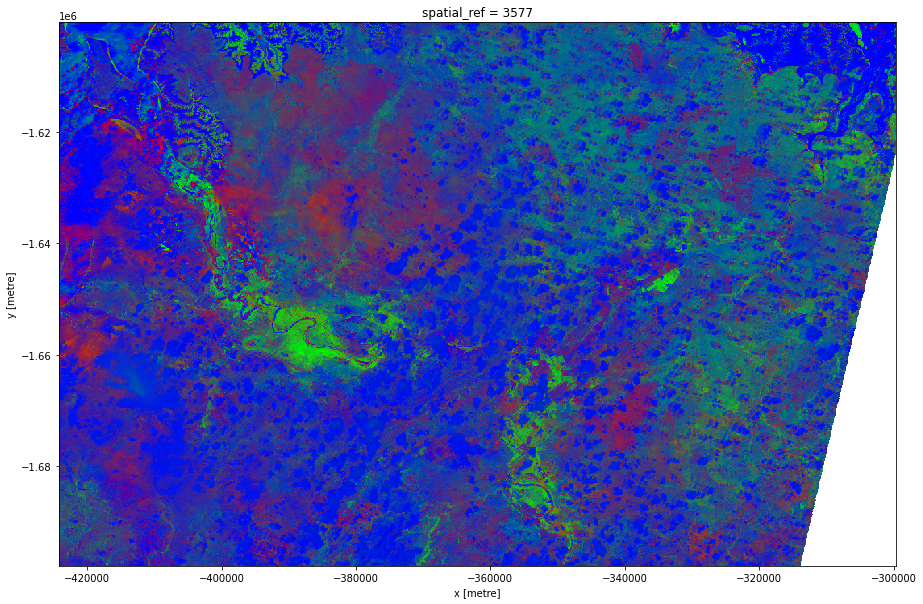

In [77]:
plot_image(apply_ows_style_cfg(enum_masked_fc_cfg, combined_data))

In [78]:
rgb_ndvi_transparency_cfg = {
    "components": {
        "red": {"red": 1.0},
        "green": {"green": 1.0},
        "blue": {"blue": 1.0},
        "alpha": {
            "function": "datacube_ows.band_utils.norm_diff",
            "kwargs": {
                "band1": "nir",
                "band2": "red",
                "scale_from": (0.0, 0.5),
                "scale_to": (0, 255)
            }
        },
    },
    "scale_range": (50, 3000),
}

In [79]:
from datacube import Datacube
dc = Datacube()
data = dc.load(
    product='ls8_nbart_geomedian_annual',
    measurements=['red', 'green', 'blue', 'nir', 'swir1', 'swir2'],
    latitude=(-16.1144, -13.4938),
    longitude=(140.7184, 145.6924),
    time=('2019-01', '2019-01'),
    output_crs="EPSG:3577",
    resolution=(-300,300)
)


/env/lib/python3.6/site-packages/datacube/drivers/postgres/_connections.py:87: SADeprecationWarning: Calling URL() directly is deprecated and will be disabled in a future release.  The public constructor for URL is now the URL.create() method.
  username=username, password=password,


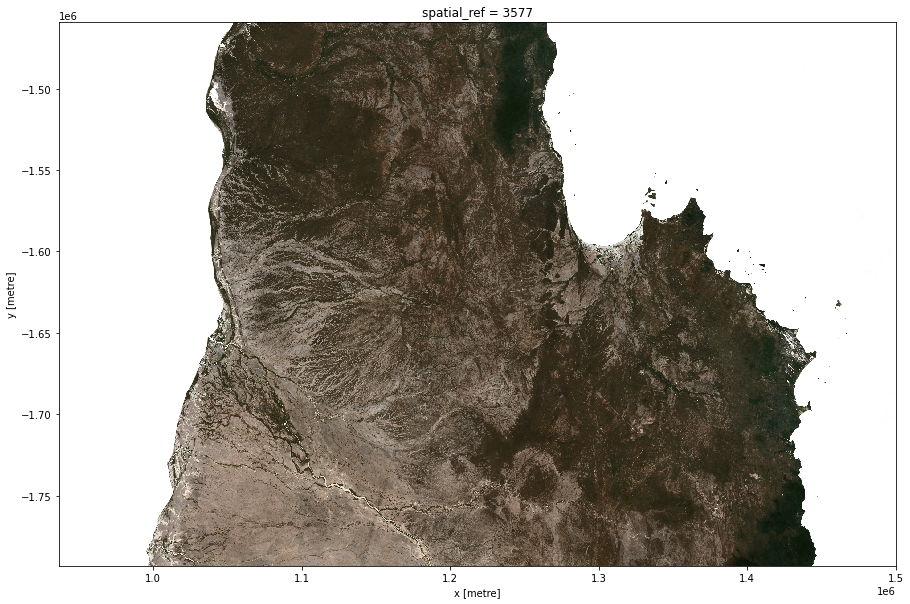

In [80]:
plot_image(apply_ows_style_cfg(rgb_ndvi_transparency_cfg, data))

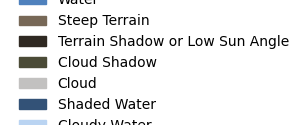

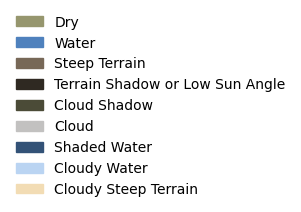

In [81]:
generate_ows_legend_style_cfg(transparency_map_config)


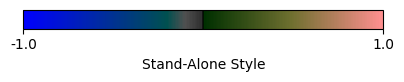

In [83]:
img= generate_ows_legend_style_cfg(ndvi_custom_ramp_cfg)